# Simulation using Concord

In [4]:
%load_ext autoreload
%autoreload 2

In [5]:
import numpy as np
import scanpy as sc
import time
from pathlib import Path
import torch
import concord as ccd
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt

from matplotlib import font_manager, rcParams
custom_rc = {
    'font.family': 'Arial',  # Set the desired font for this plot
}

mpl.rcParams['svg.fonttype'] = 'none'
mpl.rcParams['pdf.fonttype'] = 42

In [6]:
proj_name = "simulation_cluster_imbalanced_varybatch"
save_dir = f"../save/dev_{proj_name}-{time.strftime('%b%d')}/"
save_dir = Path(save_dir)
save_dir.mkdir(parents=True, exist_ok=True)

data_dir = f"../data/{proj_name}/"
data_dir = Path(data_dir)
data_dir.mkdir(parents=True, exist_ok=True)
device = torch.device('cuda:3' if torch.cuda.is_available() else 'cpu')
print(device)
seed = 0
ccd.ul.set_seed(seed)

file_suffix = f"{time.strftime('%b%d-%H%M')}"
file_suffix

cpu


'Aug11-1413'

In [7]:
concord_methods = ['concord_hcl', 'concord_knn', 'contrastive']
other_methods = [
        "unintegrated",
        "scanorama", "liger", "harmony",
        "scvi", 
]
run_methods = concord_methods + other_methods
# exclude ["UMAP", "t-SNE"] from run_method, and save as combined_keys
exclude_keys = ["PCA", "UMAP", "t-SNE"]
combined_keys = ['no_noise', 'wt_noise'] + [key for key in run_methods if key not in exclude_keys]

In [43]:
state_key = 'cluster'
batch_key = 'batch'
state_type = 'cluster'
leiden_key='leiden'
MEAN_LEVEL = 10.0
DISTRIBUTION = 'normal'
DISPERSION = 5.0

In [261]:
import numpy as np
import anndata as ad
from dataclasses import dataclass
from typing import Dict, List, Tuple, Sequence, Optional
from concord.simulation import Simulation, SimConfig, ClusterConfig, BatchConfig

# ========================== Effect library ==========================
# You can extend/tweak this freely. 'level' and 'dispersion' may be scalars or sequences.
EFFECT_LIBRARY: List[Tuple[str, Dict]] = [
    # ("variance_inflation",        {"level": [1, 4]}),  # multiplicative noise via dispersion
    # ("uniform_dropout",           {"level": [0.1, 0.4]}),
    ("downsampling",              {"level": [0.2, 0.8]}),
    ("scaling_factor",            {"level": [0.5, 2.0]}),
    # ("batch_specific_expression", {"level": [5,  5], "dispersion": [10, 10], "distribution": "normal", "feature_frac": 0.03}),
    # ("batch_specific_features",   {"level": [5,  5], "dispersion": [10, 10], "distribution": "normal", "feature_frac": 0.03}),
]

# ========================== Small utilities ==========================
def _sizes_from_fracs(total_cells: int, fracs: Sequence[float]) -> List[int]:
    fracs = np.asarray(fracs, float)
    assert np.isclose(fracs.sum(), 1.0), "cluster_fracs must sum to 1"
    sizes = np.floor(fracs * total_cells).astype(int)
    sizes[-1] += total_cells - sizes.sum()
    return sizes.tolist()

def _genes_equal_split(total_genes: int, n_clusters: int) -> List[int]:
    g = [total_genes // n_clusters] * n_clusters
    g[-1] += total_genes - sum(g)
    return g

def _random_pairwise_shared(
    n_clusters: int, rng: np.random.Generator,
    pair_prob: float = 0.0, frac_low: float = 0.0, frac_high: float = 0.0
) -> Optional[Dict[Tuple[int,int], float]]:
    """Randomly assign gene-overlap fractions to some cluster pairs (i<j)."""
    if pair_prob <= 0 or frac_high <= 0:
        return None
    d: Dict[Tuple[int,int], float] = {}
    for i in range(n_clusters):
        for j in range(i+1, n_clusters):
            if rng.random() < pair_prob:
                d[(i, j)] = float(rng.uniform(frac_low, frac_high))
    return d if d else None

# --- helper to pick a scalar from scalar-or-sequence, optionally aligned ---
def _pick_scalar(x, rng: np.random.Generator, align_idx: Optional[int] = None, default=None):
    if x is None:
        return default
    if isinstance(x, (list, tuple, np.ndarray)):
        if len(x) == 0:
            return default
        if align_idx is not None:
            return float(x[align_idx % len(x)])
        return float(rng.choice(x))
    return float(x)

def _norm_effect_spec(
    eff_type: str,
    spec: Dict,
    rng: np.random.Generator,
    *,
    default_dispersion: float = 2.0,
) -> Tuple[str, str, float, float, float]:
    """
    Returns (effect_type, distribution, level, dispersion, feature_frac).
    Accepts scalar or sequence for 'level' and 'dispersion'. If both are sequences,
    a shared index is chosen so low/high pairings stay matched.
    """
    dist = spec.get("distribution", "normal")
    ff   = float(spec.get("feature_frac", 0.0))
    lvl_raw  = spec.get("level", None)
    disp_raw = spec.get("dispersion", None)

    align_idx = None
    if isinstance(lvl_raw,  (list, tuple, np.ndarray)) and \
       isinstance(disp_raw, (list, tuple, np.ndarray)):
        align_idx = rng.integers(0, max(len(lvl_raw), len(disp_raw)))

    lvl = _pick_scalar(lvl_raw, rng, align_idx=align_idx)

    if eff_type == "variance_inflation":
        disp = _pick_scalar(disp_raw, rng, align_idx=align_idx,
                            default=(lvl if lvl is not None else default_dispersion))
        if lvl is None:
            lvl = 0.0  # not used, but keep safe placeholder
    else:
        disp = _pick_scalar(disp_raw, rng, align_idx=align_idx, default=default_dispersion)
        if lvl is None:
            defaults = {
                "batch_specific_distribution": 5.0,
                "uniform_dropout": 0.1,
                "downsampling": 0.8,
                "scaling_factor": 1.0,
                "batch_specific_expression": 5.0,
                "batch_specific_features": 5.0,
            }
            lvl = defaults.get(eff_type, 1.0)

    return eff_type, dist, float(lvl), float(disp), ff

def _build_effect_lists(
    n_batches: int,
    *,
    effects: Optional[List[Tuple[str, Dict]]] = None,
    random_from_library: bool = False,
    rng: np.random.Generator,
    default_batch_dispersion: float = 2.0,
) -> Dict[str, List]:
    etypes, dists, levels, disps, ffracs = [], [], [], [], []
    for b in range(n_batches):
        if random_from_library:
            eff_type, spec = EFFECT_LIBRARY[rng.integers(0, len(EFFECT_LIBRARY))]
        else:
            assert effects and len(effects) > 0, "Provide effects or set random_from_library=True"
            eff_type, spec = effects[b % len(effects)]
        e = _norm_effect_spec(eff_type, spec, rng, default_dispersion=default_batch_dispersion)
        etypes.append(e[0]); dists.append(e[1]); levels.append(e[2]); disps.append(e[3]); ffracs.append(e[4])
    return dict(effect_type=etypes, distribution=dists, level=levels, dispersion=disps, feature_frac=ffracs)

# =================== Core: simulate one scenario ===================
def simulate_scenario(
    *,
    total_cells: int,
    total_genes: int,
    # EITHER provide cluster_fracs OR give n_clusters and we'll draw fracs
    cluster_fracs: Optional[Sequence[float]] = None,
    n_clusters: Optional[int] = None,
    cluster_dirichlet_alpha: float = 1.0,
    mean_level: float = 10.0,
    state_distribution: str = "normal",
    state_dispersion: float | Sequence[float] = 5.0,
    # batch layout
    n_batches: int,
    batch_props: Sequence[float],
    # coverage: None → full coverage; or (min,max) to sample K clusters/batch
    clusters_per_batch: Optional[Tuple[int,int]] = None,
    # effects
    effects: Optional[List[Tuple[str, Dict]]] = None,
    random_effects: bool = False,
    # overlaps
    pair_prob: float = 0.0, pair_frac_low: float = 0.0, pair_frac_high: float = 0.0,
    # seeds
    seed_state: int = 0, seed_batches: int = 1, seed_effects: int = 2,
) -> ad.AnnData:
    rng_state   = np.random.default_rng(seed_state)
    rng_batches = np.random.default_rng(seed_batches)
    rng_effects = np.random.default_rng(seed_effects)

    # --- cluster fractions (random if not provided) ---
    if cluster_fracs is None:
        assert n_clusters is not None, "Provide n_clusters when cluster_fracs=None"
        cluster_fracs = rng_state.dirichlet([cluster_dirichlet_alpha] * n_clusters).tolist()
    else:
        n_clusters = len(cluster_fracs)

    sizes      = _sizes_from_fracs(total_cells, cluster_fracs)
    genes_per  = _genes_equal_split(total_genes, n_clusters)
    if isinstance(state_dispersion, (int, float)):
        state_dispersion = [float(state_dispersion)] * n_clusters

    # 1) State simulation
    sim_cfg = SimConfig(n_cells=sizes, n_genes=genes_per, seed=seed_state, non_neg=True, to_int=True)
    pairwise = _random_pairwise_shared(n_clusters, rng_state, pair_prob, pair_frac_low, pair_frac_high)
    state_cfg = ClusterConfig(
        n_states=n_clusters, program_structure="uniform", program_on_time_fraction=0.3,
        global_non_specific_gene_fraction=0.05, pairwise_non_specific_gene_fraction=pairwise,
        distribution=state_distribution, dispersion=list(state_dispersion), level=mean_level,
    )
    sim_state = Simulation(sim_cfg, state_cfg, BatchConfig(n_batches=1))
    ad_state  = sim_state.simulate_state()
    ad_state.obs["clust_id"] = (ad_state.obs["cluster"].str.extract(r"(\d+)").astype(int).squeeze() - 1)

    # 2) Build per-batch indices
    props = np.asarray(batch_props, float); props /= props.sum()
    parts: List[np.ndarray] = []
    for b in range(n_batches):
        if clusters_per_batch is None:
            chosen = np.arange(n_clusters)  # full coverage
        else:
            kmin, kmax = clusters_per_batch
            K = int(rng_batches.integers(kmin, kmax + 1))
            K = max(1, min(K, n_clusters))
            chosen = rng_batches.choice(n_clusters, size=K, replace=False)

        pool = np.where(ad_state.obs["clust_id"].isin(chosen))[0]
        take = int(round(props[b] * ad_state.n_obs))
        take = min(take, len(pool))
        picked = np.sort(rng_batches.choice(pool, size=take, replace=False)) if take > 0 else np.empty(0, int)
        parts.append(picked)

    # 3) Effects per batch
    eff_lists = _build_effect_lists(
        n_batches, effects=effects, random_from_library=random_effects, rng=rng_effects,
        default_batch_dispersion=5.0,
    )
    batch_cfg = BatchConfig(
        n_batches=n_batches,
        effect_type=eff_lists["effect_type"],
        distribution=eff_lists["distribution"],
        level=eff_lists["level"],
        dispersion=eff_lists["dispersion"],
        feature_frac=eff_lists["feature_frac"],
        cell_proportion=props.tolist(),
    )

    # 4) Apply effects + concat
    sim_full = Simulation(sim_cfg, state_cfg, batch_cfg)
    post = []
    for b, idx in enumerate(parts):
        pre_b = ad_state[idx].copy()
        pre_b.obs["batch"] = f"batch_{b+1}"
        post_b = sim_full.simulate_batch(pre_b.copy(), batch_idx=b)
        post.append(post_b)

    adata = sim_full._finalize_anndata(post, join="outer")
    adata.layers["counts"] = adata.X.copy()
    return adata

# ================= Suite driver: four scenarios =================
@dataclass
class ScenarioCfg:
    label: str
    n_clusters: int
    cluster_fracs: Optional[Sequence[float]]   # None → draw via Dirichlet
    n_batches: int
    batch_props: Sequence[float]
    clusters_per_batch: Optional[Tuple[int,int]]  # None → full coverage
    effects: Optional[List[Tuple[str, Dict]]] = None
    random_effects: bool = False
    dirichlet_alpha: Optional[float] = None      # for batch proportions
    total_cells: Optional[int] = None
    total_genes: Optional[int] = None
    cluster_dirichlet_alpha: float = 1.0         # for random cluster_fracs

def simulate_two_sets_suite(
    *,
    total_cells: int = 4000,   # default if scenario doesn’t override
    total_genes: int = 2000,   # default if scenario doesn’t override
    mean_level: float = 10.0,
    state_distribution: str = "normal",
    state_dispersion: float = 7.0,
    pair_prob: float = 0.0, pair_frac_low: float = 0.05, pair_frac_high: float = 0.30,
    seed: int = 42,
) -> Dict[str, ad.AnnData]:
    rng = np.random.default_rng(seed)

    # Set A: 2 scenarios, 1000×1000, full coverage (fixed cluster_fracs)
    setA = [
        ScenarioCfg(
            label="A_2b_equal_4c",
            n_clusters=4, cluster_fracs=(0.4,0.3,0.2,0.1),
            n_batches=2, batch_props=(0.5,0.5), clusters_per_batch=None,
            effects=[("downsampling", {"level":0.8}),
                     ("scaling_factor", {"level":2.0})],
            total_cells=1000, total_genes=1000,
        ),
        ScenarioCfg(
            label="A_2b_1to10_4c",
            n_clusters=4, cluster_fracs=(0.4,0.3,0.2,0.1),
            n_batches=2, batch_props=(10,1), clusters_per_batch=None,
            effects=[("downsampling", {"level":0.8}),
                     ("scaling_factor", {"level":2.0})],
            total_cells=1000, total_genes=1000,
        ),
    ]

    # Set B: 2 scenarios, 2000×2000, partial coverage, random cluster_fracs
    setB = [
        ScenarioCfg(
            label="B_10b_rand_8c",
            n_clusters=8, cluster_fracs=None,  # draw via Dirichlet
            n_batches=10, batch_props=(), clusters_per_batch=(2,8),
            random_effects=True, dirichlet_alpha=1.0,  # batch imbalance (moderate)
            cluster_dirichlet_alpha=1.0,               # cluster size imbalance 
            total_cells=2000, total_genes=2000,
        ),
        ScenarioCfg(
            label="B_30b_rand_8c",
            n_clusters=8, cluster_fracs=None,
            n_batches=30, batch_props=(), clusters_per_batch=(2,8),
            random_effects=True, dirichlet_alpha=0.5,  # more batch imbalance
            cluster_dirichlet_alpha=1.0,
            total_cells=3000, total_genes=2000,
        ),
    ]

    results: Dict[str, ad.AnnData] = {}

    for s_idx, sc in enumerate([*setA, *setB]):
        # batch proportions
        if sc.dirichlet_alpha is not None:
            props = rng.dirichlet([sc.dirichlet_alpha] * sc.n_batches)
        else:
            props = np.asarray(sc.batch_props, float)
        props = (props / props.sum()).tolist()

        # per-scenario sizes
        t_cells = sc.total_cells if sc.total_cells is not None else total_cells
        t_genes = sc.total_genes if sc.total_genes is not None else total_genes

        adata = simulate_scenario(
            total_cells=t_cells, total_genes=t_genes,
            cluster_fracs=sc.cluster_fracs, n_clusters=sc.n_clusters,
            cluster_dirichlet_alpha=sc.cluster_dirichlet_alpha,
            n_batches=sc.n_batches, batch_props=props,
            clusters_per_batch=sc.clusters_per_batch,
            mean_level=mean_level, state_distribution=state_distribution, state_dispersion=state_dispersion,
            effects=sc.effects, random_effects=sc.random_effects,
            pair_prob=pair_prob, pair_frac_low=pair_frac_low, pair_frac_high=pair_frac_high,
            seed_state=seed + 10 + s_idx, seed_batches=seed + 1000 + s_idx, seed_effects=seed + 2000 + s_idx,
        )
        adata.obs["scenario"] = sc.label
        results[sc.label] = adata
        print(f"{sc.label:>16} | cells={adata.n_obs:,}  genes={adata.n_vars:,}")

    return results

# ========================== Example usage ==========================



In [262]:
adata_dict = simulate_two_sets_suite(
    mean_level=10.0,
    state_distribution="normal",
    state_dispersion=10.0,
    pair_prob=0.0,  # set >0 to enable random cluster-pair gene overlaps
    seed=1,
)

   A_2b_equal_4c | cells=1,000  genes=1,000
   A_2b_1to10_4c | cells=1,000  genes=1,000
   B_10b_rand_8c | cells=1,999  genes=2,000
   B_30b_rand_8c | cells=3,000  genes=2,000


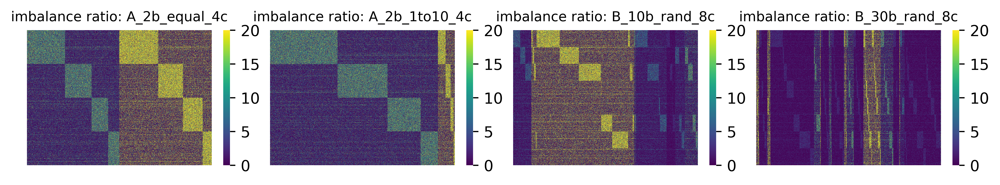

In [263]:
import matplotlib.pyplot as plt
figsize = (2.3, 1.8)
ncols = len(adata_dict)
title_fontsize = 9
dpi = 600
fig, axes = plt.subplots(1, ncols, figsize=(figsize[0] * ncols, figsize[1]), dpi=dpi)
for i, (ratio, adata) in enumerate(adata_dict.items()):
    ccd.pl.heatmap_with_annotations(adata, val='X', obs_keys=[state_key, batch_key], ax = axes[i], vmax=20, use_clustermap=False, yticklabels=False, cluster_cols=False, cluster_rows=False, value_annot=False, cmap='viridis', title=f"imbalance ratio: {ratio}", save_path=None, figsize=figsize, dpi=dpi, title_fontsize=title_fontsize)
plt.tight_layout(w_pad=0.0, h_pad=0.1)
plt.savefig(save_dir / f"data_heatmaps_{file_suffix}.svg", dpi=dpi, bbox_inches='tight')

### Integration pipeline

In [256]:
run_methods = concord_methods + other_methods
run_methods = concord_methods
latent_dim = 30

In [257]:
run_methods = ['concord_hcl', 'concord_knn', 'scvi']
# run_methods = [
#         "unintegrated",
#         "scanorama", "liger", "harmony",
# ]

In [258]:
concord_kwargs = {
    'batch_size': 32,
    'n_epochs': 20,
    'preload_dense': True,
    'verbose': False,
}
for i, (ratio, adata) in enumerate(adata_dict.items()):
    print(f"Processing imbalance ratio: {ratio}")
    ccd.ul.run_pca(adata, source_key='no_noise', result_key='PCA_no_noise', n_pc=latent_dim, random_state=seed)
    ccd.ul.run_pca(adata, source_key='wt_noise', result_key='PCA_wt_noise', n_pc=latent_dim, random_state=seed)
    # Put the PCA result in the adata object, so only one object is needed
    adata.obsm['no_noise'] = adata.obsm['PCA_no_noise']
    adata.obsm['wt_noise'] = adata.obsm['PCA_wt_noise']
    # sc.pp.pca(adata, n_comps=latent_dim, random_state=seed)

    profile_logs = ccd.bm.run_integration_methods_pipeline(
        adata=adata,                          
        methods=run_methods,            # List of methods to run
        batch_key=batch_key,                    # Column in adata.obs for batch info
        count_layer="counts",                 # Layer name containing raw counts
        class_key=state_key,               # Column in adata.obs for class labels (used in SCANVI and CONCORD variants)
        latent_dim=latent_dim,                        # Latent dimensionality for PCA and embeddings
        device="cpu",                        # Or "cpu", or "mps" for Apple Silicon
        return_corrected=False,                   # Whether to store corrected expression matrices
        transform_batch=None,                 # Optionally specify a batch to transform to in scVI
        seed=seed,                              # Random seed for reproducibility
        compute_umap=False,                        # Run UMAP for all output embeddings
        umap_n_components=2,
        umap_n_neighbors=30,
        umap_min_dist=0.5,
        verbose=True,                        # Print progress messages
        save_dir=save_dir,
        concord_kwargs=concord_kwargs,
    )


Processing imbalance ratio: A_2b_equal_4c
concord - WARNING - save_dir is None. Model and log files will not be saved.
concord - WARNING - Input data in adata.X appears to be raw counts. CONCORD performs best on normalized and log-transformed data. Consider setting normalize_total=True and log1p=True.
concord - WARNING - No input feature list provided. It is recommended to first select features using the command `concord.ul.select_features()`.
Epoch 0 Training
Epoch 1 Training
concord - WARNING - FAISS not found. Using sklearn for k-NN computation.
Epoch 2 Training
Epoch 3 Training
Epoch 4 Training
Epoch 5 Training
Epoch 6 Training
Epoch 7 Training
Epoch 8 Training
Epoch 9 Training
Epoch 10 Training
Epoch 11 Training
Epoch 12 Training
Epoch 13 Training
Epoch 14 Training
Epoch 15 Training
Epoch 16 Training
Epoch 17 Training
Epoch 18 Training
Epoch 19 Training
concord - WARNING - save_dir is None. Skipping model/config saving.


concord_knn: 2.87s | 30.97 MB RAM | 0.00 MB VRAM


concord - WARNING - save_dir is None. Model and log files will not be saved.
concord - WARNING - Input data in adata.X appears to be raw counts. CONCORD performs best on normalized and log-transformed data. Consider setting normalize_total=True and log1p=True.
concord - WARNING - No input feature list provided. It is recommended to first select features using the command `concord.ul.select_features()`.
Epoch 0 Training
Epoch 1 Training
Epoch 2 Training
Epoch 3 Training
Epoch 4 Training
Epoch 5 Training
Epoch 6 Training
Epoch 7 Training
Epoch 8 Training
Epoch 9 Training
Epoch 10 Training
Epoch 11 Training
Epoch 12 Training
Epoch 13 Training
Epoch 14 Training
Epoch 15 Training
Epoch 16 Training
Epoch 17 Training
Epoch 18 Training
Epoch 19 Training
concord - WARNING - save_dir is None. Skipping model/config saving.


concord_hcl: 2.31s | 10.16 MB RAM | 0.00 MB VRAM
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


Training:   0%|          | 0/400 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=400` reached.
Saved scVI model to ../save/dev_simulation_cluster_imbalanced_varybatch-Aug11/scvi_model.pt
scvi: 30.34s | 0.62 MB RAM | 0.00 MB VRAM
✅ All selected methods completed.


Processing imbalance ratio: A_2b_1to10_4c
concord - WARNING - save_dir is None. Model and log files will not be saved.
concord - WARNING - Input data in adata.X appears to be raw counts. CONCORD performs best on normalized and log-transformed data. Consider setting normalize_total=True and log1p=True.
concord - WARNING - No input feature list provided. It is recommended to first select features using the command `concord.ul.select_features()`.
Epoch 0 Training
Epoch 1 Training
concord - WARNING - FAISS not found. Using sklearn for k-NN computation.
Epoch 2 Training
Epoch 3 Training
Epoch 4 Training
Epoch 5 Training
Epoch 6 Training
Epoch 7 Training
Epoch 8 Training
Epoch 9 Training
Epoch 10 Training
Epoch 11 Training
Epoch 12 Training
Epoch 13 Training
Epoch 14 Training
Epoch 15 Training
Epoch 16 Training
Epoch 17 Training
Epoch 18 Training
Epoch 19 Training
concord - WARNING - save_dir is None. Skipping model/config saving.


concord_knn: 2.95s | 3.83 MB RAM | 0.00 MB VRAM


concord - WARNING - save_dir is None. Model and log files will not be saved.
concord - WARNING - Input data in adata.X appears to be raw counts. CONCORD performs best on normalized and log-transformed data. Consider setting normalize_total=True and log1p=True.
concord - WARNING - No input feature list provided. It is recommended to first select features using the command `concord.ul.select_features()`.
Epoch 0 Training
Epoch 1 Training
Epoch 2 Training
Epoch 3 Training
Epoch 4 Training
Epoch 5 Training
Epoch 6 Training
Epoch 7 Training
Epoch 8 Training
Epoch 9 Training
Epoch 10 Training
Epoch 11 Training
Epoch 12 Training
Epoch 13 Training
Epoch 14 Training
Epoch 15 Training
Epoch 16 Training
Epoch 17 Training
Epoch 18 Training
Epoch 19 Training
concord - WARNING - save_dir is None. Skipping model/config saving.


concord_hcl: 2.46s | 0.00 MB RAM | 0.00 MB VRAM
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


Training:   0%|          | 0/400 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=400` reached.
Saved scVI model to ../save/dev_simulation_cluster_imbalanced_varybatch-Aug11/scvi_model.pt
scvi: 30.32s | 0.00 MB RAM | 0.00 MB VRAM
✅ All selected methods completed.


Processing imbalance ratio: B_10b_rand_8c
concord - WARNING - save_dir is None. Model and log files will not be saved.
concord - WARNING - Input data in adata.X appears to be raw counts. CONCORD performs best on normalized and log-transformed data. Consider setting normalize_total=True and log1p=True.
concord - WARNING - No input feature list provided. It is recommended to first select features using the command `concord.ul.select_features()`.
Epoch 0 Training
Epoch 1 Training
concord - WARNING - FAISS not found. Using sklearn for k-NN computation.
Epoch 2 Training
Epoch 3 Training
Epoch 4 Training
Epoch 5 Training
Epoch 6 Training
Epoch 7 Training
Epoch 8 Training
Epoch 9 Training
Epoch 10 Training
Epoch 11 Training
Epoch 12 Training
Epoch 13 Training
Epoch 14 Training
Epoch 15 Training
Epoch 16 Training
Epoch 17 Training
Epoch 18 Training
Epoch 19 Training
concord - WARNING - save_dir is None. Skipping model/config saving.


concord_knn: 8.12s | 0.00 MB RAM | 0.00 MB VRAM


concord - WARNING - save_dir is None. Model and log files will not be saved.
concord - WARNING - Input data in adata.X appears to be raw counts. CONCORD performs best on normalized and log-transformed data. Consider setting normalize_total=True and log1p=True.
concord - WARNING - No input feature list provided. It is recommended to first select features using the command `concord.ul.select_features()`.
Epoch 0 Training
Epoch 1 Training
Epoch 2 Training
Epoch 3 Training
Epoch 4 Training
Epoch 5 Training
Epoch 6 Training
Epoch 7 Training
Epoch 8 Training
Epoch 9 Training
Epoch 10 Training
Epoch 11 Training
Epoch 12 Training
Epoch 13 Training
Epoch 14 Training
Epoch 15 Training
Epoch 16 Training
Epoch 17 Training
Epoch 18 Training
Epoch 19 Training
concord - WARNING - save_dir is None. Skipping model/config saving.


concord_hcl: 6.69s | 0.00 MB RAM | 0.00 MB VRAM
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


Training:   0%|          | 0/400 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=400` reached.
Saved scVI model to ../save/dev_simulation_cluster_imbalanced_varybatch-Aug11/scvi_model.pt
scvi: 76.43s | 0.58 MB RAM | 0.00 MB VRAM
✅ All selected methods completed.


Processing imbalance ratio: B_30b_rand_8c
concord - WARNING - save_dir is None. Model and log files will not be saved.
concord - WARNING - Input data in adata.X appears to be raw counts. CONCORD performs best on normalized and log-transformed data. Consider setting normalize_total=True and log1p=True.
concord - WARNING - No input feature list provided. It is recommended to first select features using the command `concord.ul.select_features()`.
Epoch 0 Training
Epoch 1 Training
concord - WARNING - FAISS not found. Using sklearn for k-NN computation.
Epoch 2 Training
Epoch 3 Training
Epoch 4 Training
Epoch 5 Training
Epoch 6 Training
Epoch 7 Training
Epoch 8 Training
Epoch 9 Training
Epoch 10 Training
Epoch 11 Training
Epoch 12 Training
Epoch 13 Training
Epoch 14 Training
Epoch 15 Training
Epoch 16 Training
Epoch 17 Training
Epoch 18 Training
Epoch 19 Training
concord - WARNING - save_dir is None. Skipping model/config saving.


concord_knn: 11.87s | 0.00 MB RAM | 0.00 MB VRAM


concord - WARNING - save_dir is None. Model and log files will not be saved.
concord - WARNING - Input data in adata.X appears to be raw counts. CONCORD performs best on normalized and log-transformed data. Consider setting normalize_total=True and log1p=True.
concord - WARNING - No input feature list provided. It is recommended to first select features using the command `concord.ul.select_features()`.
Epoch 0 Training
Epoch 1 Training
Epoch 2 Training
Epoch 3 Training
Epoch 4 Training
Epoch 5 Training
Epoch 6 Training
Epoch 7 Training
Epoch 8 Training
Epoch 9 Training
Epoch 10 Training
Epoch 11 Training
Epoch 12 Training
Epoch 13 Training
Epoch 14 Training
Epoch 15 Training
Epoch 16 Training
Epoch 17 Training
Epoch 18 Training
Epoch 19 Training
concord - WARNING - save_dir is None. Skipping model/config saving.


concord_hcl: 9.55s | 0.00 MB RAM | 0.00 MB VRAM
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


Training:   0%|          | 0/400 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=400` reached.
Saved scVI model to ../save/dev_simulation_cluster_imbalanced_varybatch-Aug11/scvi_model.pt
scvi: 109.17s | 0.00 MB RAM | 0.00 MB VRAM
✅ All selected methods completed.


In [259]:
for i, (ratio, adata) in enumerate(adata_dict.items()):
    print(f"Processing imbalance ratio: {ratio}")
    for basis in run_methods:
        if basis not in adata.obsm:
            print(f"Warning: {basis} not found in adata.obsm, skipping UMAP.")
            continue
        print("Running UMAP for", basis)
        #if 'UMAP' not in basis:
        ccd.ul.run_umap(adata, source_key=basis, result_key=f'{basis}_UMAP', n_components=2, n_neighbors=30, min_dist=0.5, metric='euclidean', random_state=seed)

Processing imbalance ratio: A_2b_equal_4c
Running UMAP for concord_hcl
Running UMAP for concord_knn
Running UMAP for scvi
Processing imbalance ratio: A_2b_1to10_4c
Running UMAP for concord_hcl
Running UMAP for concord_knn
Running UMAP for scvi
Processing imbalance ratio: B_10b_rand_8c
Running UMAP for concord_hcl
Running UMAP for concord_knn
Running UMAP for scvi
Processing imbalance ratio: B_30b_rand_8c
Running UMAP for concord_hcl
Running UMAP for concord_knn
Running UMAP for scvi


Processing imbalance ratio: A_2b_equal_4c


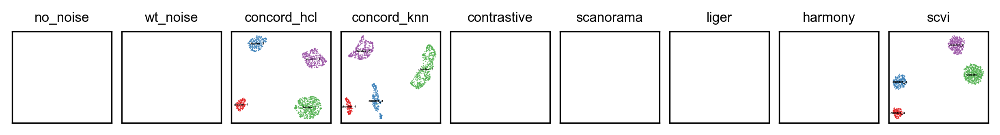

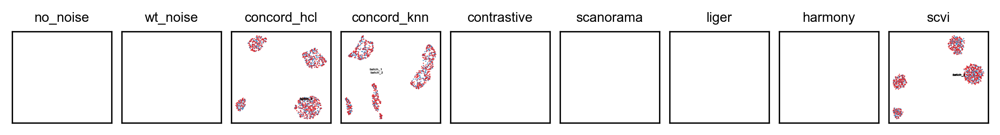

Processing imbalance ratio: A_2b_1to10_4c


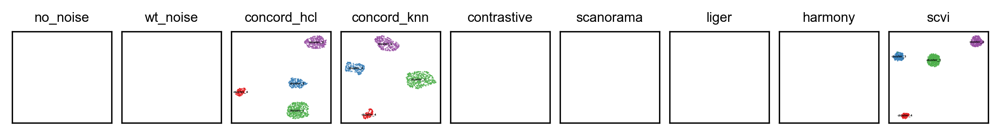

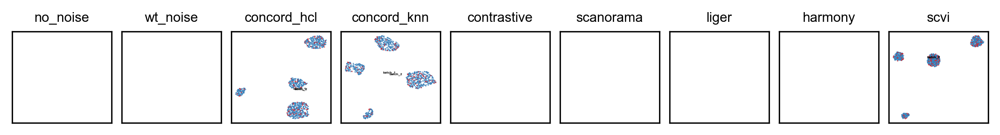

Processing imbalance ratio: B_10b_rand_8c


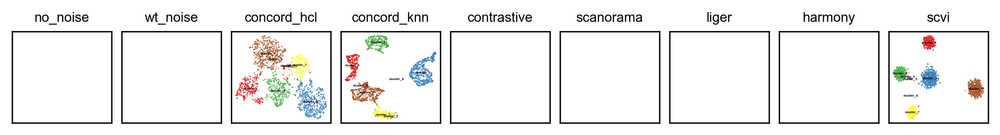

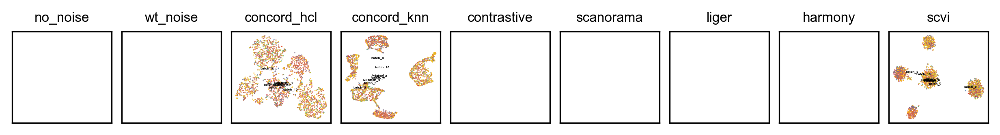

Processing imbalance ratio: B_30b_rand_8c


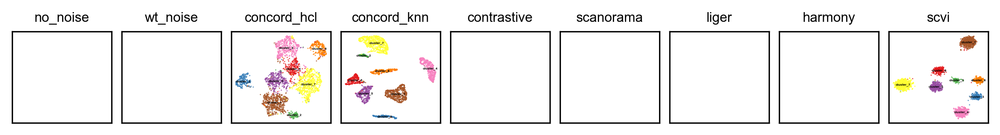

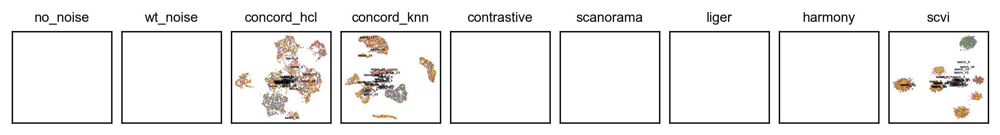

In [260]:
# plot everything
import matplotlib.pyplot as plt

show_keys = [key for key in combined_keys if key != 'unintegrated']
# check which methods are run successfully
color_bys = [state_key, batch_key]
basis_types = ['UMAP']
#basis_types = ['KNN']
font_size=8
point_size=2
alpha=0.8
figsize=(0.9*len(show_keys),1)
ncols = len(show_keys)
nrows = int(np.ceil(len(show_keys) / ncols))
pal = {'time':'viridis', 'batch':'Set1'}
k=15
edges_color='grey'
edges_width=0
layout='kk'
threshold = 0.1
node_size_scale=0.1
edge_width_scale=0.1

rasterized = True

for i, (ratio, adata) in enumerate(adata_dict.items()):
    print(f"Processing imbalance ratio: {ratio}")

    with plt.rc_context(rc=custom_rc):
        ccd.pl.plot_all_embeddings(
            adata,
            show_keys,
            color_bys=color_bys,
            basis_types=basis_types,
            pal=pal,
            k=k,
            edges_color=edges_color,
            edges_width=edges_width,
            layout=layout,
            threshold=threshold,
            node_size_scale=node_size_scale,
            edge_width_scale=edge_width_scale,
            font_size=font_size,
            point_size=point_size,
            alpha=alpha,
            rasterized=rasterized,
            figsize=figsize,
            ncols=ncols,
            seed=seed,
            leiden_key='leiden',
            legend_loc = "on data",
            save_dir=save_dir,
            file_suffix=file_suffix+ f"_{ratio}",
            save_format='svg'
        )


In [76]:
# Save adata_dict to file
import pickle
with open(save_dir / f"adata_dict_{file_suffix}.pkl", 'wb') as f:
    pickle.dump(adata_dict, f)  

print(f"Saved adata_dict to {save_dir / f'adata_dict_{file_suffix}.pkl'}")

Saved adata_dict to ../save/dev_simulation_cluster_imbalancep1-Jul26/adata_dict_Jul26-1919.pkl


Processing imbalance ratio: 1 with 2000 cells and 1200 genes
Processing imbalance ratio: 5 with 1999 cells and 1200 genes
Processing imbalance ratio: 20 with 1999 cells and 1200 genes


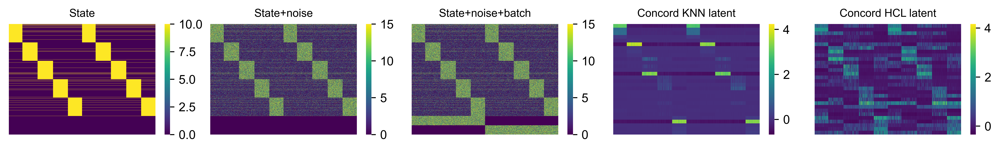

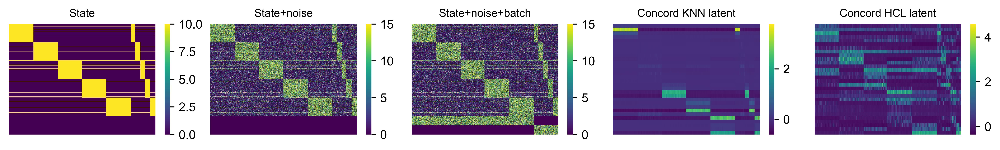

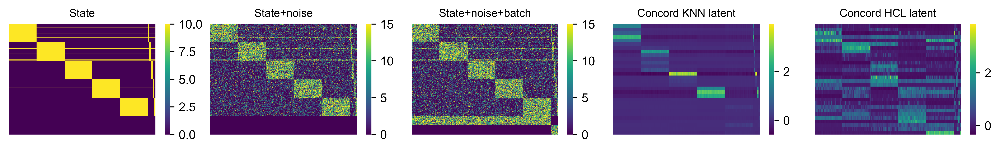

In [12]:
# Plot heatmap of original data and Concord latent
import matplotlib.pyplot as plt
figsize = (2.3, 1.8)
ncols = 5
title_fontsize = 9
for i, (ratio, adata) in enumerate(adata_dict.items()):
    print(f"Processing imbalance ratio: {ratio} with {len(adata.obs)} cells and {len(adata.var)} genes")
    batch_id=adata.obs['batch'].unique()[0]
    batch_indices = np.where(adata.obs['batch'] == batch_id)[0]
    _, _, _, feature_order = ccd.ul.sort_and_smooth_signal_along_path(adata, signal_key='concord_knn', path=batch_indices, sigma=2)
    adata.obsm['concord_knn_sorted'] = adata.obsm['concord_knn'][:, feature_order]
    _, _, _, feature_order = ccd.ul.sort_and_smooth_signal_along_path(adata, signal_key='concord_hcl', path=batch_indices, sigma=2)
    adata.obsm['concord_hcl_sorted'] = adata.obsm['concord_hcl'][:, feature_order]
    # Run concord latent
    _, _, state_pal = ccd.pl.get_color_mapping(adata, state_key, pal='Paired', seed=seed)
    _, _, batch_pal = ccd.pl.get_color_mapping(adata, batch_key, pal='Set1', seed=seed)
    pal = {state_key: state_pal, batch_key: batch_pal}
    dpi = 600
    with plt.rc_context(rc=custom_rc):
        fig, axes = plt.subplots(1, ncols, figsize=(figsize[0] * ncols, figsize[1]), dpi=dpi)
        ccd.pl.heatmap_with_annotations(adata, val='no_noise', obs_keys=[state_key], ax = axes[0], use_clustermap=False, pal=pal, yticklabels=False, cluster_cols=False, cluster_rows=False, value_annot=False, cmap='viridis', title='State', save_path=None, figsize=figsize, dpi=dpi, title_fontsize=title_fontsize)
        ccd.pl.heatmap_with_annotations(adata, val='wt_noise', vmax=15, obs_keys=[state_key], ax = axes[1], use_clustermap=False, pal=pal, yticklabels=False, cluster_cols=False, cluster_rows=False, value_annot=False, cmap='viridis', title='State+noise', save_path=None, figsize=figsize, dpi=dpi, title_fontsize=title_fontsize)
        ccd.pl.heatmap_with_annotations(adata, val='X', vmax=15, obs_keys=[state_key, batch_key], ax = axes[2], use_clustermap=False, pal=pal, yticklabels=False, cluster_cols=False, cluster_rows=False, value_annot=False, cmap='viridis', title='State+noise+batch', save_path=None, figsize=figsize, dpi=dpi, title_fontsize=title_fontsize)
        ccd.pl.heatmap_with_annotations(adata, val='concord_knn_sorted', obs_keys=[state_key, batch_key], ax = axes[3], use_clustermap=False, pal=pal, yticklabels=False, cluster_cols=False, cluster_rows=False, value_annot=False, cmap='viridis', title='Concord KNN latent', save_path=None, figsize=figsize, dpi=dpi, title_fontsize=title_fontsize)
        ccd.pl.heatmap_with_annotations(adata, val='concord_hcl_sorted', obs_keys=[state_key, batch_key], ax = axes[4], use_clustermap=False, pal=pal, yticklabels=False, cluster_cols=False, cluster_rows=False, value_annot=False, cmap='viridis', title='Concord HCL latent', save_path=None, figsize=figsize, dpi=dpi, title_fontsize=title_fontsize)
        plt.tight_layout(w_pad=0.0, h_pad=0.1)
        plt.savefig(save_dir / f"all_heatmaps_{ratio}_{file_suffix}.svg", dpi=dpi, bbox_inches='tight')

# Evaluation

In [15]:
# Load adata_dict from file
import pickle
with open(Path('../save/dev_simulation_cluster_imbalancep1-Jul26/adata_dict_Jul26-1919.pkl'), 'rb') as f:
    adata_dict = pickle.load(f) 

concord - INFO - Running SCIB benchmark


Embeddings: 100%|██████████| 10/10 [00:10<00:00,  1.07s/it]


concord - INFO - Running Probe benchmark
Detected task: classification
[KNN] detected task: classification
concord - INFO - Computing cell distance correlation
concord - INFO - Computing trustworthiness
concord - INFO - Computing state dispersion correlation
concord - INFO - Saved full geometry benchmark results to ../save/dev_simulation_cluster_imbalancep1-Jul29/benchmarks_out/geometry_results_Jul29-1352_1.pkl


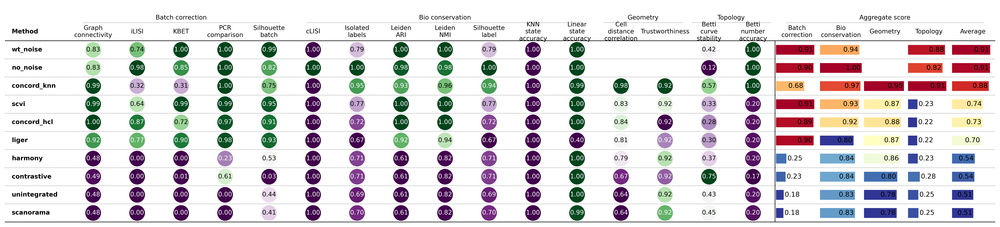

concord - INFO - Saved benchmark results to ../save/dev_simulation_cluster_imbalancep1-Jul29/benchmarks_out/benchmark_results_Jul29-1352_1.pkl
concord - INFO - Running SCIB benchmark


Embeddings: 100%|██████████| 10/10 [00:10<00:00,  1.10s/it]


concord - INFO - Running Probe benchmark
Detected task: classification
[KNN] detected task: classification
concord - INFO - Computing cell distance correlation
concord - INFO - Computing trustworthiness
concord - INFO - Computing state dispersion correlation
concord - INFO - Saved full geometry benchmark results to ../save/dev_simulation_cluster_imbalancep1-Jul29/benchmarks_out/geometry_results_Jul29-1352_5.pkl


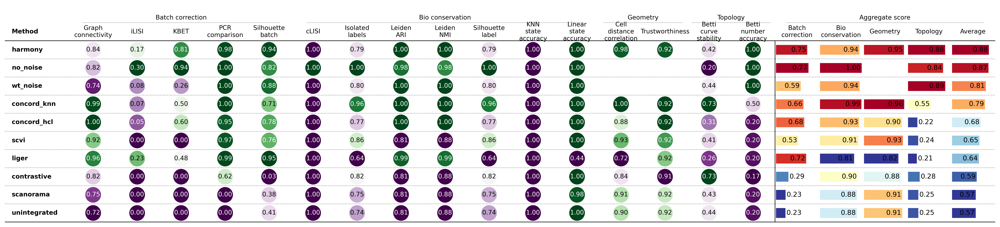

concord - INFO - Saved benchmark results to ../save/dev_simulation_cluster_imbalancep1-Jul29/benchmarks_out/benchmark_results_Jul29-1352_5.pkl
concord - INFO - Running SCIB benchmark


Embeddings: 100%|██████████| 10/10 [00:09<00:00,  1.03it/s]


concord - INFO - Running Probe benchmark
Detected task: classification
[KNN] detected task: classification
concord - INFO - Computing cell distance correlation
concord - INFO - Computing trustworthiness
concord - INFO - Computing state dispersion correlation
concord - INFO - Saved full geometry benchmark results to ../save/dev_simulation_cluster_imbalancep1-Jul29/benchmarks_out/geometry_results_Jul29-1352_20.pkl


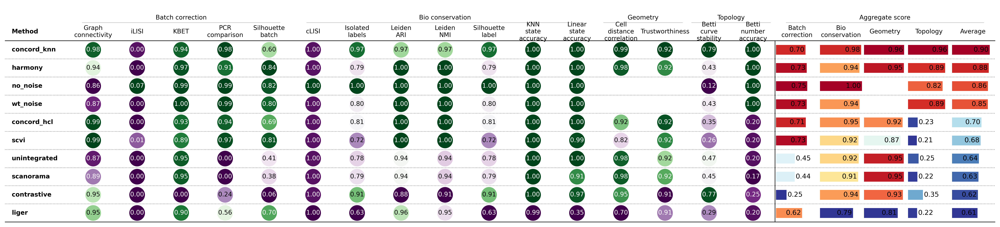

concord - INFO - Saved benchmark results to ../save/dev_simulation_cluster_imbalancep1-Jul29/benchmarks_out/benchmark_results_Jul29-1352_20.pkl


In [17]:
bm_results = {}
for i, (ratio, adata) in enumerate(adata_dict.items()):
    out = ccd.bm.run_benchmark_pipeline(
        adata,
        embedding_keys=combined_keys,
        state_key=state_key,
        batch_key=batch_key,
        groundtruth_key="no_noise",  # use the Leiden clusters as ground truth
        save_dir=save_dir / "benchmarks_out",
        run=("scib", "probe", "geometry", "topology"),          # run only these blocks
        plot_individual=False,          # skip the intermediate PDFs
        expected_betti_numbers=[4,0,0],  # expected Betti numbers for the geometry and topology blocks
        max_points=1000,
        file_suffix=f"{file_suffix}_{ratio}",  # suffix for the output files
        seed=seed,  # for reproducibility
    )
    bm_results[ratio] = out  # Store the results for this imbalance ratio
    combined = out["combined"]

In [81]:
# Save benchmark results
import pickle
with open(save_dir / f"benchmark_results_{file_suffix}.pkl", 'wb') as f:
    pickle.dump(bm_results, f)

print(f"Saved benchmark results to {save_dir / f'benchmark_results_{file_suffix}.pkl'}")

Saved benchmark results to ../save/dev_simulation_cluster_imbalancep1-Jul26/benchmark_results_Jul26-1919.pkl


Imbalance ratio: 1


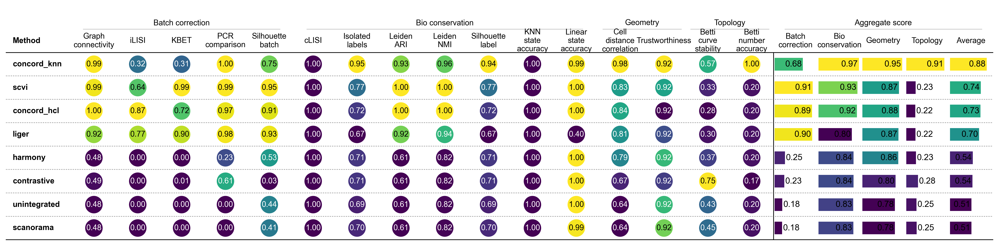

Imbalance ratio: 5


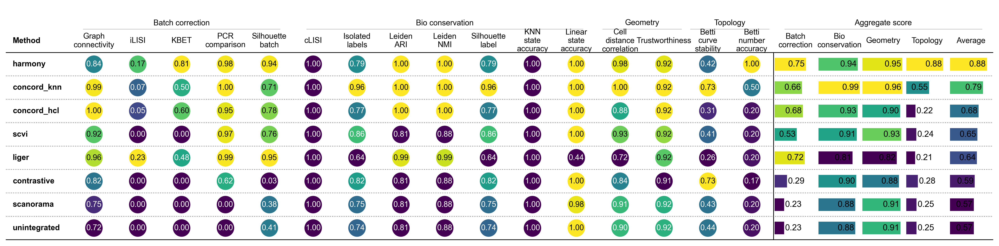

Imbalance ratio: 20


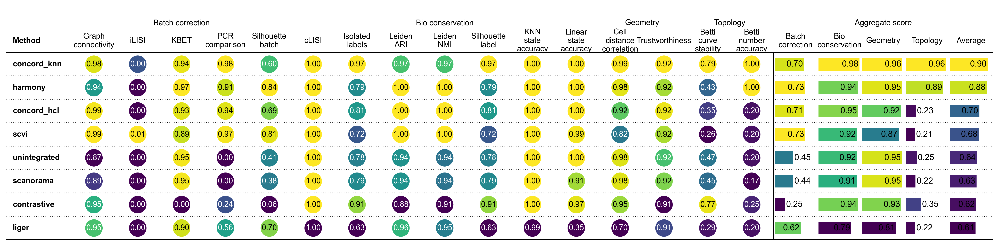

In [82]:
# Load benchmark results
import pickle
bm_results = pickle.load(open(Path('../save/dev_simulation_cluster_imbalancep1-Jul26/benchmark_results_Jul26-1919.pkl'), "rb"))

for ratio, out in bm_results.items():
    print(f"Imbalance ratio: {ratio}")
    table_plot_kw = dict(
            pal="viridis", pal_agg="viridis", cmap_method="minmax", dpi=300)
    with plt.rc_context(rc=custom_rc):
        combined_df = ccd.bm.combine_benchmark_results(
            out,
            block_include=("geometry", "topology", "scib", "probe"),
            plot=False,
            save_path=save_dir / f"combined_res_{file_suffix}.pdf",
            table_plot_kw=table_plot_kw,
        )
        ccd.bm.plot_benchmark_table(
                combined_df.dropna(axis=0, how='any'),
                save_path=save_dir / f"benchmark_table_{file_suffix}.svg",
                agg_name="Aggregate score",
                figsize=(25, 6),
                **table_plot_kw
                )